<a href="https://colab.research.google.com/github/9645258/aiffel/blob/main/E-10/%5BE-10%5Dexploration.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **🎄 EXPLORATION 10**

 - **🌲 EXPLORATION 10-1 : 인물 모드 문제점 찾기**  
    - **🌿 01_데이터 준비**  
        - **🍃 01-1_필요 라이브러리 import**  

# **🌲 EXPLORATION 10-1 : 인물 모드 시작해보기**

## **🌿 01_데이터 준비**

### **🍃 01-1_필요 라이브러리 import**

- **os** (운영체제)  
- **cv2** (이미지 처리)  
- **urllib** (웹 크롤링)  
- **numpy** (수치 계산)  
- **pixellib.semantic** (시맨틱 세그멘테이션)  
- **warnings** (경고 무시)  
- **matplotlib** (시각화)

In [52]:
! pip install pixellib

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [53]:
import os
import cv2
import urllib
import numpy as np

from pixellib.semantic import semantic_segmentation

import warnings
warnings.filterwarnings(action='ignore')

import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

### **🍃 01-2_필요 데이터 import**

- **구글 드라이브 mount**

In [54]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [55]:
% cd /content/drive/MyDrive/Colab Notebooks/aiffel/01-2_exploration/E-10/data

/content/drive/MyDrive/Colab Notebooks/aiffel/01-2_exploration/E-10/data


- **이미지 데이터 import**

In [56]:
img_path = '/content/drive/MyDrive/Colab Notebooks/aiffel/01-2_exploration/E-10/data/img_00.png'
img_orig = cv2.imread(img_path)

## **🌿 02_데이터 확인**

### **🍃 02-1_이미지 확인**

In [57]:
print(img_orig.shape)

(1000, 800, 3)


### **🍃 02-2_이미지 컬러 출력 변경**

- **BGR→RGB로 출력 변경**

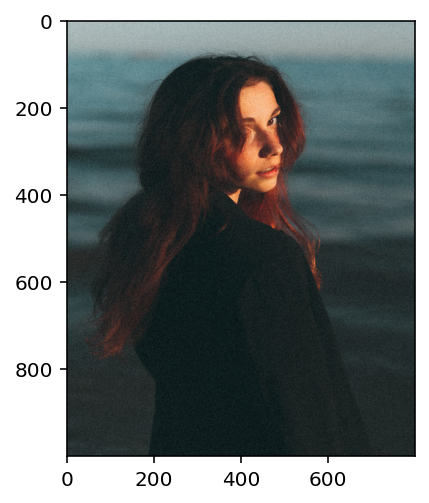

In [58]:
plt.imshow(cv2.cvtColor(img_orig, cv2.COLOR_BGR2RGB))
plt.show()

In [59]:
model_dir = os.getenv('HOME')+'/aiffel/human_segmentation/models'
model_file = os.path.join(model_dir, 'deeplabv3_xception_tf_dim_ordering_tf_kernels.h5')

## **🌿 03_세그멘테이션 모델**

### **🍃 03-1_모델 다운로드**

- **PixelLib에서 제공해 주는 모델 다운로드**

In [60]:
model_dir = '/content/drive/MyDrive/Colab Notebooks/aiffel/01-2_exploration/E-10/data/'
model_file = os.path.join(model_dir, 'deeplabv3_xception_tf_dim_ordering_tf_kernels.h5')

model_url = 'https://github.com/ayoolaolafenwa/PixelLib/releases/download/1.1/deeplabv3_xception_tf_dim_ordering_tf_kernels.h5'

urllib.request.urlretrieve(model_url, model_file)

('/content/drive/MyDrive/Colab Notebooks/aiffel/01-2_exploration/E-10/data/deeplabv3_xception_tf_dim_ordering_tf_kernels.h5',
 <http.client.HTTPMessage at 0x7f9073a67f10>)

### **🍃 03-2_모델 생성**

- **PixelLib로 세그멘테이션 모델 생성**

In [61]:
model = semantic_segmentation()
model.load_pascalvoc_model(model_file)

### **🍃 03-3_이미지 입력 및 출력**

- **모델에 이미지 입력**

In [62]:
segvalues, output = model.segmentAsPascalvoc(img_path)

- **출력 이미지 확인**
세그멘테이션이 된 결과가 각각 다른 색상으로 출력

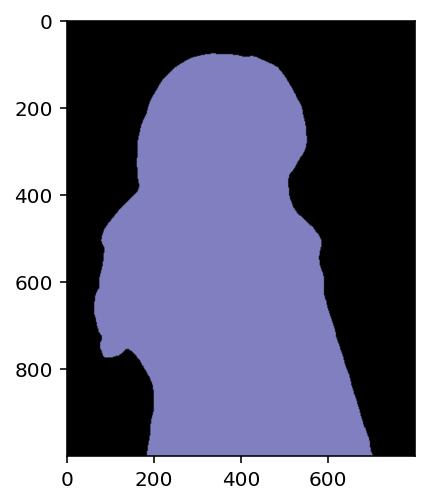

In [63]:
plt.imshow(output)
plt.show()

### **🍃 03-4_PASCAL VOC 데이터 라벨**

- **background 제외하면 20개의 클래스 (0부터 시작)**

In [64]:
LABEL_NAMES = [
    'background', 'aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus',
    'car', 'cat', 'chair', 'cow', 'diningtable', 'dog', 'horse', 'motorbike',
    'person', 'pottedplant', 'sheep', 'sofa', 'train', 'tv'
]
len(LABEL_NAMES)

21

### **🍃 03-5_이미지 세그멘테이션 결과 확인**

- **segvalues**  
class_ids, masks 존재

In [65]:
segvalues

{'class_ids': array([ 0, 15]),
 'masks': array([[False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        ...,
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False]])}

- **어떤 물체가 담겨 있는지 확인**

In [66]:
for class_id in segvalues['class_ids']:
    print(LABEL_NAMES[class_id])

background
person


### **🍃 03-6_colormap 생성**

- **해당 색을 사용한 colormap 생성**

In [67]:
colormap = np.zeros((256, 3), dtype = int)
ind = np.arange(256, dtype=int)
for shift in reversed(range(8)):
    for channel in range(3):
        colormap[:, channel] |= ((ind >> channel) & 1) << shift
    ind >>= 3

- **사람(15)의 경우 192,128,128(RGB)로 확인됨**  
- **output 이미지는 BGR 순서로 배치되므로 색상 값 순서 변환 필요 (128, 128, 192)**

In [68]:
colormap[15]

array([192, 128, 128])

- **최종적으로 담긴 물체와 colormap 확인**

In [69]:
for class_id in segvalues['class_ids']:
    print(LABEL_NAMES[class_id], colormap[class_id])

background [0 0 0]
person [192 128 128]


## **🌿 04_세그멘테이션 모델 성능 확인**

### **🍃 03-1_seg_color로 이루어진 마스크 생성**

- **사람의 colormap RGB 값**

In [70]:
seg_color = (128,128,192)

- **output의 픽셀 별로 색상이 seg_color와 같다면 1(True), 다르다면 0(False)**

(1000, 800)


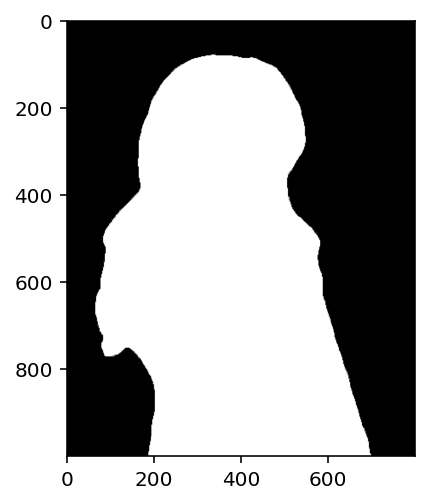

In [71]:
seg_map = np.all(output==seg_color, axis=-1)
print(seg_map.shape)
plt.imshow(seg_map, cmap='gray')
plt.show()

### **🍃 03-2_원본 이미지와 겹쳐 보며 세그멘테이션 확인**

In [72]:
img_show = img_orig.copy()

- **True과 False인 값을 각각 255과 0으로 변환**

In [73]:
img_mask = seg_map.astype(np.uint8) * 255

- **255와 0을 적당한 색상으로 변환**

In [74]:
color_mask = cv2.applyColorMap(img_mask, cv2.COLORMAP_JET)

- **원본 이미지와 마스트를 적당히 겹침**  
- **두 이미지를 섞는 비율: 0.6 / 0.4**

In [79]:
img_show = cv2.addWeighted(img_show, 0.6, color_mask, 0.4, 0.0)

- **출력해서 시각적으로 확인**

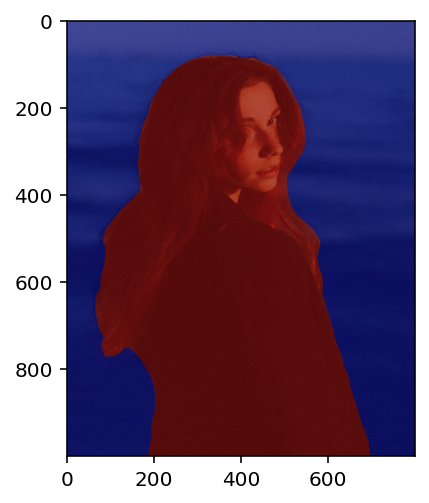

In [80]:
plt.imshow(cv2.cvtColor(img_show, cv2.COLOR_BGR2RGB))
plt.show()

## **🌿 05_배경 흐리게 하기**

### **🍃 05-1_이미지 흐림 처리**

- **blur()함수를 활용한 배경 흐림 처리**  
값이 커질수록 흐림의 강도가 심해짐  
blurring kernel size: 30, 30

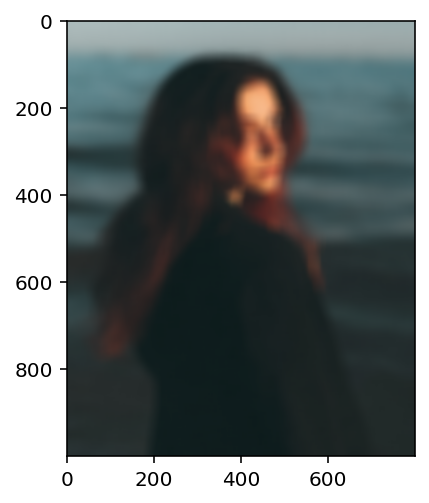

In [81]:
img_orig_blur = cv2.blur(img_orig, (30,30))  
plt.imshow(cv2.cvtColor(img_orig_blur, cv2.COLOR_BGR2RGB))
plt.show()

### **🍃 05-2_세그멘테이션 마스크를 이용한 배경 추출**

- **흐려진 이미지에서 배경만 추출**  
bitwise_not 함수: 이미지 반전  
원래 마스크에서 배경 0, 사람 255 → 배경 255, 사람 0

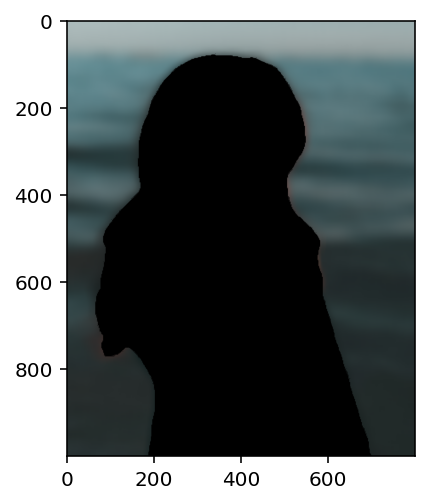

In [82]:
img_mask_color = cv2.cvtColor(img_mask, cv2.COLOR_GRAY2BGR)
img_bg_mask = cv2.bitwise_not(img_mask_color)
img_bg_blur = cv2.bitwise_and(img_orig_blur, img_bg_mask)
plt.imshow(cv2.cvtColor(img_bg_blur, cv2.COLOR_BGR2RGB))
plt.show()

## **🌿 06_흐린 배경과 원본 합성**

- **세그멘테이션 마스크가 255인 부분만 원본 이미지 값을 가지고 오고 아닌 영역은 블러된 이미지 값을 사용**  
numpy.where (조건 만족 인덱스 반환)  

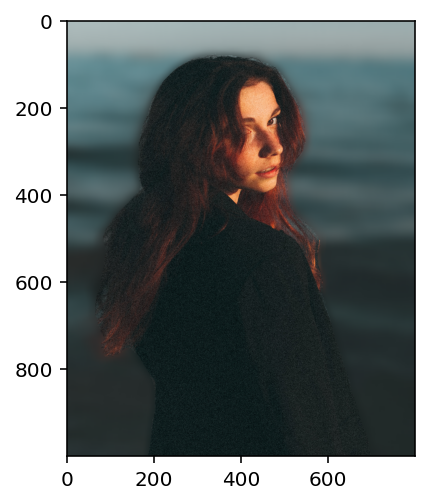

In [83]:
img_concat = np.where(img_mask_color==255, img_orig, img_bg_blur)
plt.imshow(cv2.cvtColor(img_concat, cv2.COLOR_BGR2RGB))
plt.show()

# **🌲 EXPLORATION 10-2 : 인물 모드 문제점 찾기**

## **🌿 01_함수 제작**

In [255]:
def portrait_mode(file, obj, back = None):
    '''
    인물모드 함수 제작
    '''
    # 1. 이미지 데이터 import
    img_path = '/content/drive/MyDrive/Colab Notebooks/aiffel/01-2_exploration/E-10/data/' + file  
    img_orig = cv2.imread(img_path)

    # 2. 모델 다운로드
    model_dir = '/content/drive/MyDrive/Colab Notebooks/aiffel/01-2_exploration/E-10/data/'
    model_file = os.path.join(model_dir, 'deeplabv3_xception_tf_dim_ordering_tf_kernels.h5')
    model_url = 'https://github.com/ayoolaolafenwa/PixelLib/releases/download/1.1/deeplabv3_xception_tf_dim_ordering_tf_kernels.h5'
    urllib.request.urlretrieve(model_url, model_file)

    # 3. 모델 생성
    model = semantic_segmentation()
    model.load_pascalvoc_model(model_file)

    # 4. 이미지 입력
    segvalues, output = model.segmentAsPascalvoc(img_path)

    # 5. PASCAL VOC 데이터 라벨
    LABEL_NAMES = [
        'background', 'aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus',
        'car', 'cat', 'chair', 'cow', 'diningtable', 'dog', 'horse', 'motorbike',
        'person', 'pottedplant', 'sheep', 'sofa', 'train', 'tv'
    ]

    # 6. colormap 생성
    colormap = np.zeros((256, 3), dtype = int)
    ind = np.arange(256, dtype=int)

    for shift in reversed(range(8)):
        for channel in range(3):
            colormap[:, channel] |= ((ind >> channel) & 1) << shift
        ind >>= 3

    # 7. seg_color로 이루어진 마스크 생성
    # 7-1. 인식된 이미지의 colormap RGB 값
    seg_color = tuple(colormap[LABEL_NAMES.index(obj)][::-1])
    # 7-2. output의 픽셀 별로 색상이 seg_color와 같다면 1(True), 다르다면 0(False)
    seg_map = np.all(output==seg_color, axis=-1)

    plt.figure(figsize=(15, 12))

    # 원본 이미지
    plt.subplot(231)
    plt.title('original')
    plt.imshow(cv2.cvtColor(img_orig, cv2.COLOR_BGR2RGB))

    # 블러 적용
    img_orig_blur = cv2.blur(img_orig, (13,13))
    plt.subplot(232)
    plt.title('blur')
    plt.imshow(cv2.cvtColor(img_orig_blur, cv2.COLOR_BGR2RGB))

    # 세그멘테이션 확인 / 255와 0을 적당한 색상으로 변환 (0.5 비율로 확인)
    img_show = img_orig.copy()
    img_mask = seg_map.astype(np.uint8) * 255
    color_mask = cv2.applyColorMap(img_mask, cv2.COLORMAP_JET)
    img_show = cv2.addWeighted(img_show, 0.5, color_mask, 0.5, 0.0)
    plt.subplot(233)
    plt.title('segmentation')
    plt.imshow(cv2.cvtColor(img_show, cv2.COLOR_BGR2RGB))

    # 배경 추출
    img_mask_color = cv2.cvtColor(img_mask, cv2.COLOR_GRAY2BGR)
    img_bg_mask = cv2.bitwise_not(img_mask_color)
    img_bg_blur = cv2.bitwise_and(img_orig_blur, img_bg_mask)
    plt.subplot(234)
    plt.title('extraction bg')
    plt.imshow(cv2.cvtColor(img_bg_blur, cv2.COLOR_BGR2RGB))

    # 원본 합성
    img_concat = np.where(img_mask_color==255, img_orig, img_bg_blur)
    plt.subplot(235)
    plt.title('composite')
    plt.imshow(cv2.cvtColor(img_concat, cv2.COLOR_BGR2RGB))
    
    # 배경 변경
    img_path = '/content/drive/MyDrive/Colab Notebooks/aiffel/01-2_exploration/E-10/data/' + back
    img_back = cv2.imread(img_path) 
    img_resized = cv2.resize(img_orig, (img_back.shape[1], img_back.shape[0]))
    img_mask_resized = cv2.resize(img_mask_color, (img_back.shape[1], img_back.shape[0]))
    img_background_concat = np.where(img_mask_resized == 255, img_resized, img_back)
    plt.subplot(236)
    plt.title('add bg')
    plt.imshow(cv2.cvtColor(img_background_concat, cv2.COLOR_BGR2RGB))

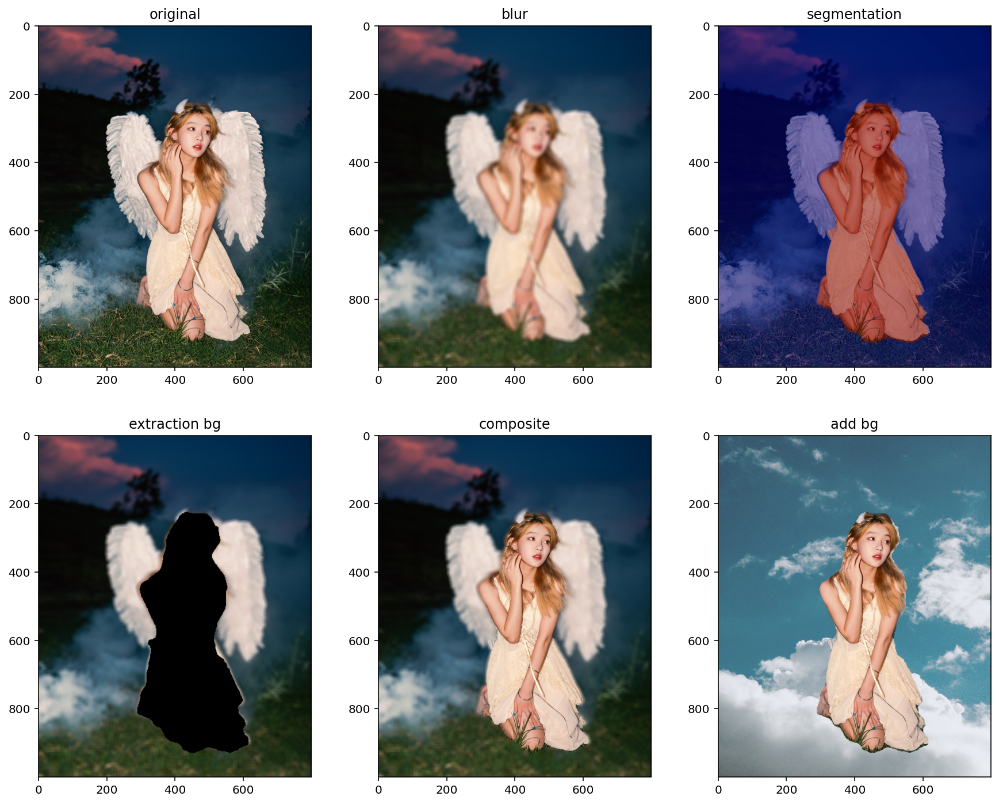

In [256]:
portrait_mode('img_01.png', 'person','bg_01.png')

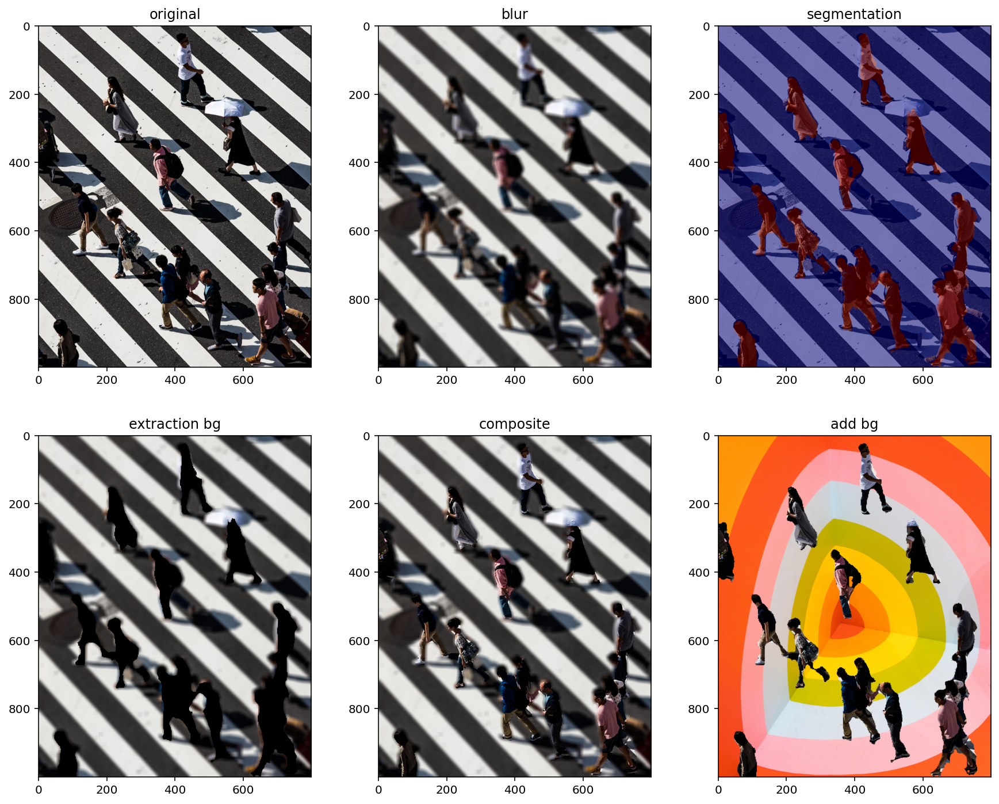

In [258]:
portrait_mode('img_02.png', 'person','bg_02.png')

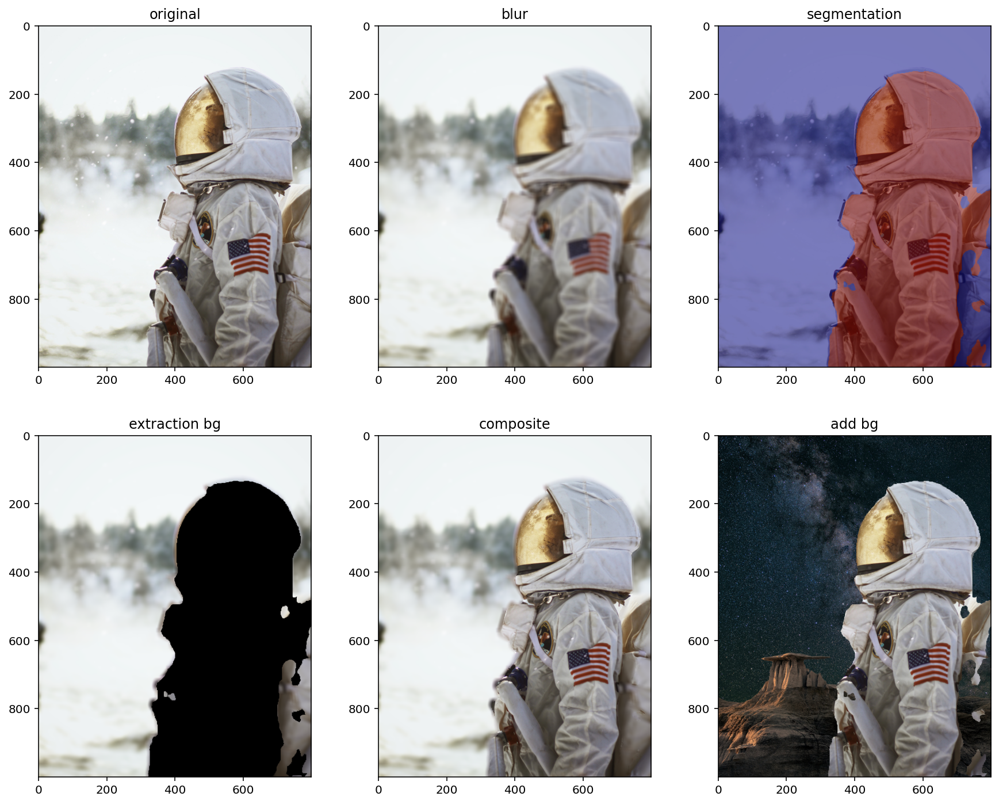

In [260]:
portrait_mode('img_03.png', 'person','bg_03.png')

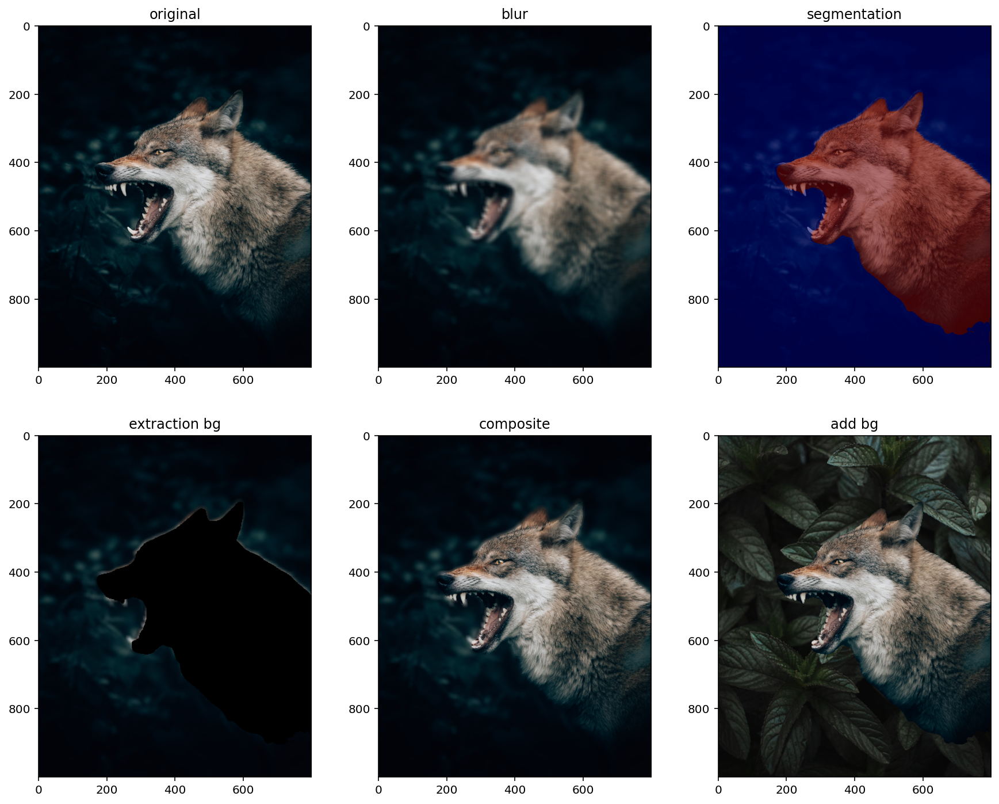

In [261]:
portrait_mode('img_04.png', 'dog','bg_04.png')

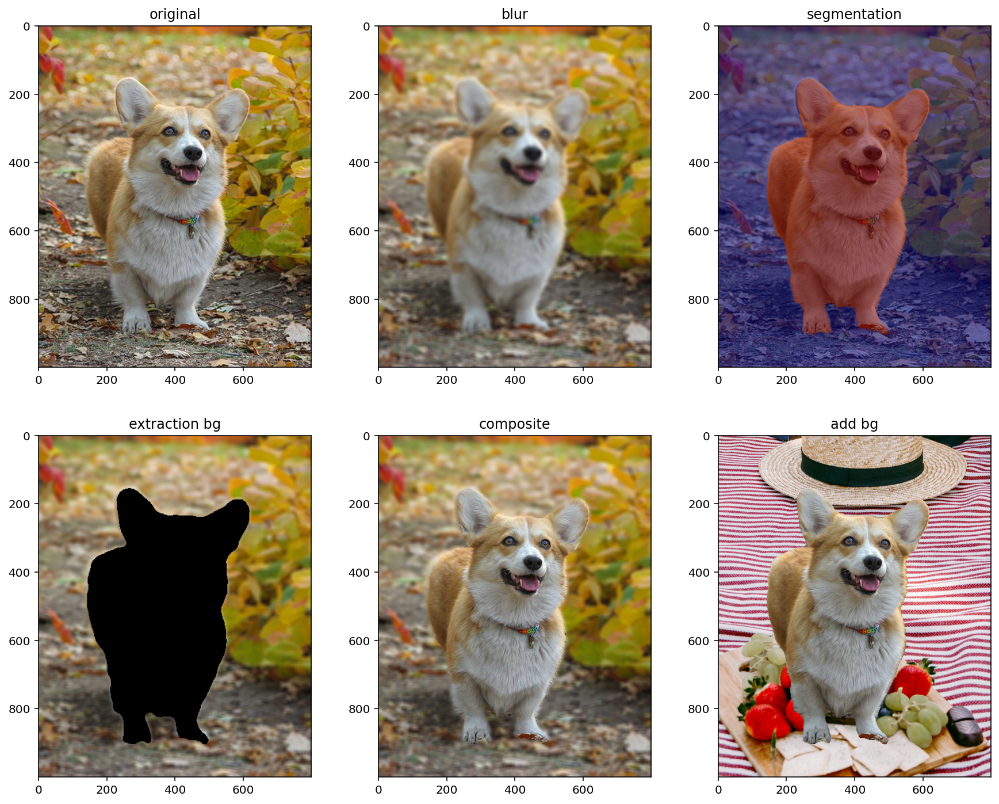

In [262]:
portrait_mode('img_05.png', 'dog','bg_05.png')

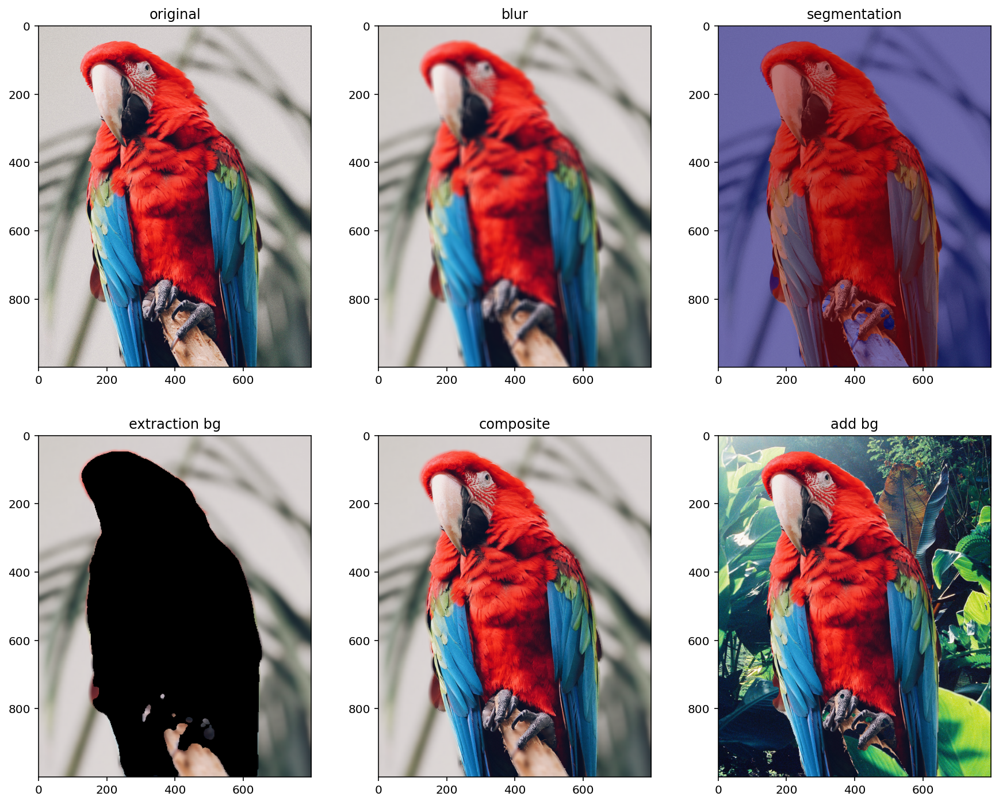

In [265]:
portrait_mode('img_06.png', 'bird','bg_06.png')

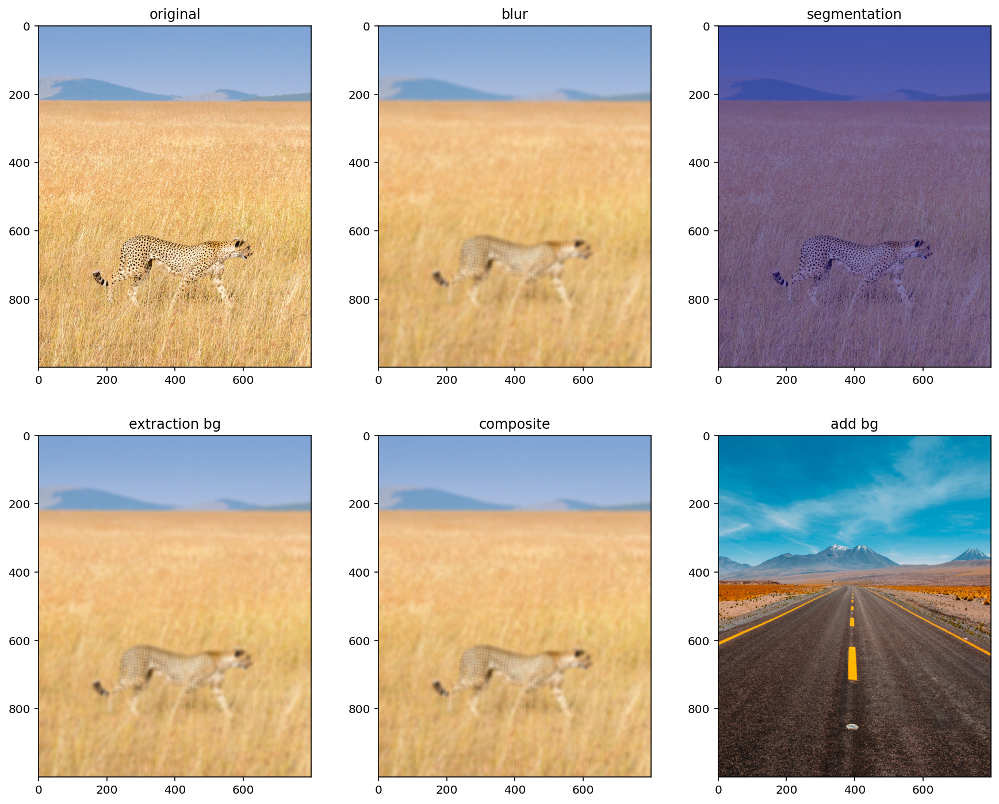

In [266]:
portrait_mode('img_07.png', 'cat','bg_07.png')

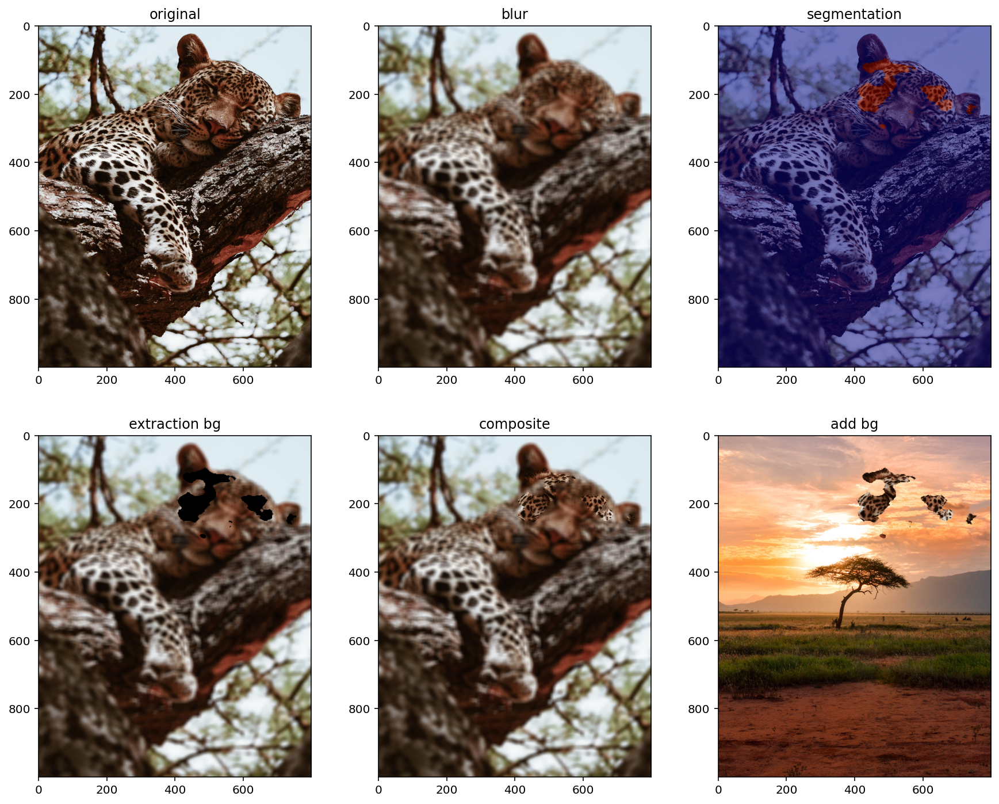

In [267]:
portrait_mode('img_08.png', 'cat','bg_08.png')

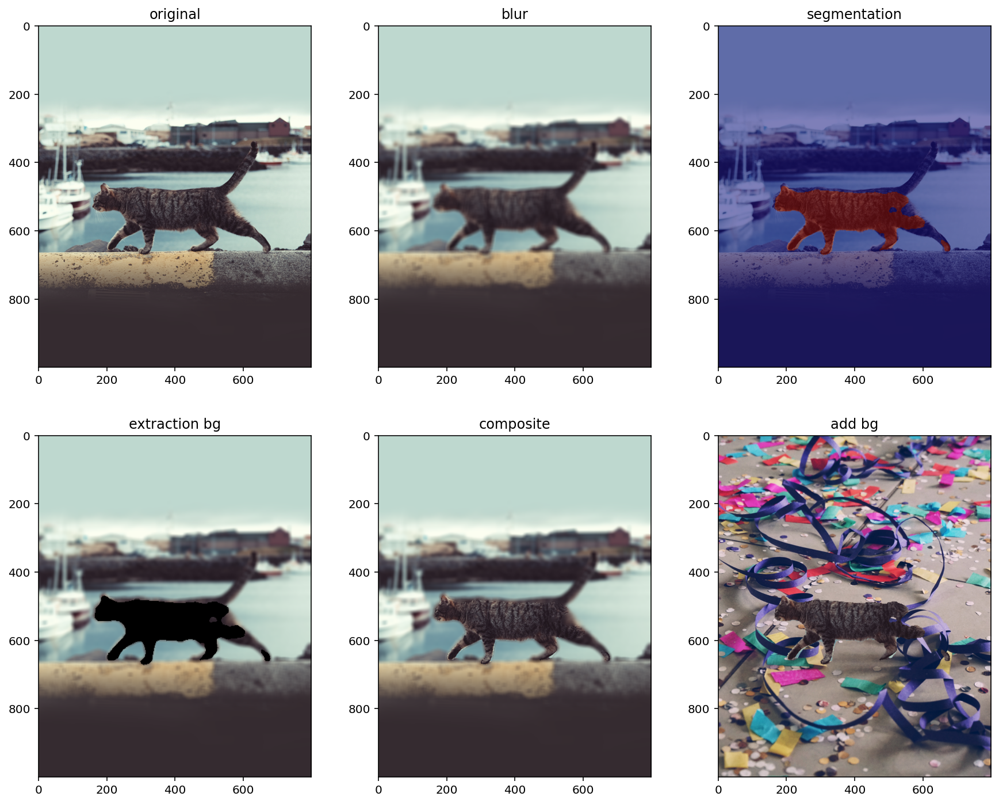

In [269]:
portrait_mode('img_09.png', 'cat','bg_09.png')

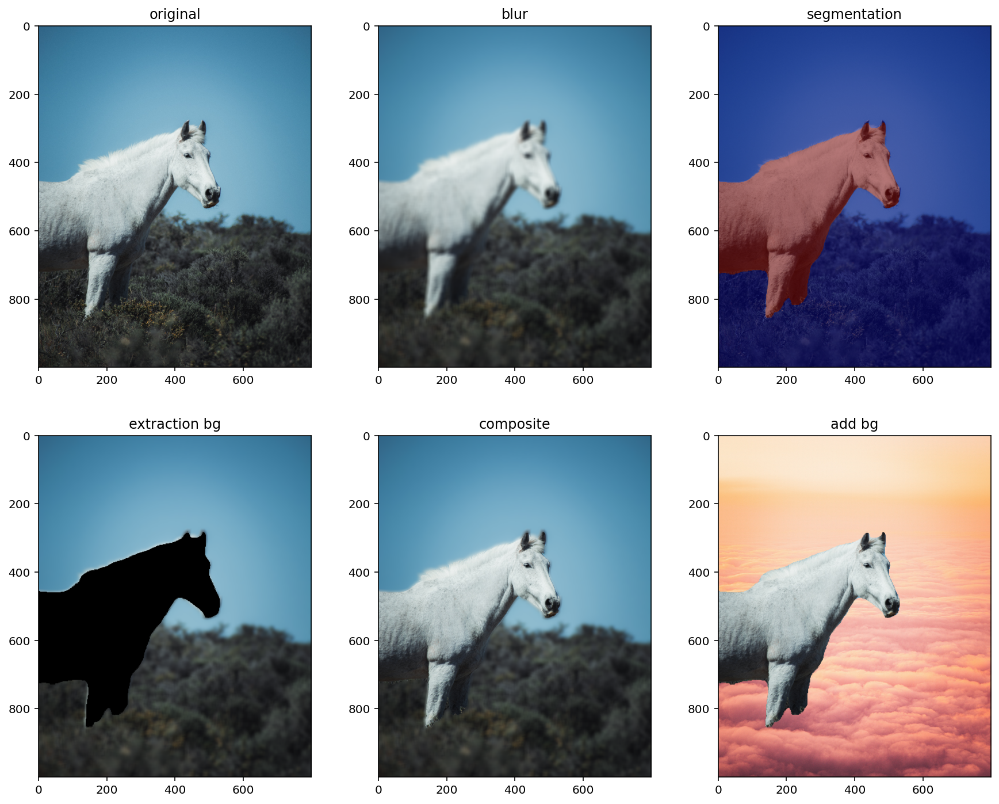

In [271]:
portrait_mode('img_10.png', 'horse','bg_10.png')

# **🌲 EXPLORATION 10-3 : 회고**

## **🌿 01_EXPLORATION 회고**

## **🌿 02_이번 회차 회고**